# Design

### Imports

In [1]:
# Standard librairies

import json
import sys                                    # Required to import my libraries.
from typing import Dict, List, Union

# Third-party librairies

import numpy as np
import PIL
import plotly.graph_objects as go
import plotly.subplots as psub
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import SubsetRandomSampler
import torchvision
from torchvision.datasets import ImageFolder
from torchvision.transforms import *

# My libraries

sys.path.insert(0, "../")
from landmark import *

# Print parameters

import plotly.io as pio                       # Need this so plotly images in a Jupyter notebook show up in GitHub.
pio.renderers.default="plotly_mimetype"


### Variables

In [2]:
# Directories of train-test data
dir_train = "../data/landmark_images/train"
dir_test = "../data/landmark_images/test"

# File containing image categories & indexes
file_categories = "categories.json"

# Model checkpoints & metrics files
file_scratch_checkpoint = "model_scratch_checkpoint.pt"
file_scratch_metrics = "model_scratch_metrics.json"
file_transfer_checkpoint = "model_transfer_checkpoint.pt"
file_transfer_metrics = "model_transfer_metrics.json"

# Dummy file for predictions
file_testme = "../testme.jpg"

# Device for calculations (CPU/GPU)
device = "cuda" if torch.cuda.is_available else "cpu"


### Data Loaders

In [3]:
# Get DataLoaders

dls = get_data_loaders(dir_train, None, dir_test, 0.25)


In [4]:
def plot_imagefolder_transforms(dt: ImageFolder,
                                idx_img: int = 0,
                                figure_title: str = "Data Processing") -> None:
    """Plot image transformation steps from an ImageFolder.
    
    Inputs
    
    dt           ImageFolder containing transforms to plot.
    idx_img      Index of image to use for plot.
    
    """
    
    # Image transforms
    
    trs = dt.transform.transforms
    n_trs = len(trs)
    
    # Original image
    
    rgb_path = dt.samples[idx_img][0]
    rgb = PIL.Image.open(rgb_path)
    
    # Titles & images for each subplot
    
    subplot_titles = ["Original Image"]
    rgbs = [rgb]
    
    for tr in trs:
        
        subplot_titles.append(tr.__class__.__name__)
        rgbs.append(tr(rgbs[-1]))
        
    # Figure parameters

    n_rows = 1
    n_cols = len(rgbs)
    
    # Create figure    
    
    fig = psub.make_subplots(rows=n_rows, cols=n_cols, subplot_titles = subplot_titles)
    
    for i in range(n_cols):
        
        rgb = rgbs[i]
        if type(rgb) == torch.Tensor:
            rgb = ToPILImage()(rgb)    # Convers tensors to PIL image
        trace = go.Image(z=rgb)
        fig.add_trace(trace, row=1, col=i+1)
    
    fig.layout.title.text = figure_title
        
    fig.show()                        

# Plot ImageFolder transforms
#
# Do not print if you don't need to as this
# output makes the Notebook really big (~200 Mb)

idx_img = 0
# plot_imagefolder_transforms(dls["train"].dataset, idx_img, "Data Pre-Processing - train") 
# plot_imagefolder_transforms(dls["valid"].dataset, idx_img, "Data Pre-Processing - valid") 
# plot_imagefolder_transforms(dls["test"].dataset, idx_img, "Data Pre-Processing - test") 
 

### CNN 1 - From Scratch

In [5]:
# Instantiate CNN built from scratch 

model_scratch = get_model_scratch()
print(model_scratch)

NeuralNetworkScratch(
  (conv_1_1): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv_1_2): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv_2_1): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv_2_2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv_3_1): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv_3_2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (max_pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (fc_1): Linear(in_features=50176, out_features=1000, bias=True)
  (fc_2): Linear(in_features=1000, out_features=50, bias=True)
  (relu): ReLU()
  (dropout): Dropout(p=0.2, inplace=False)
  (log_softmax): LogSoftmax(dim=1)
)


In [6]:
# Sanity check: make predictions of untrained model
# (probabilities should all be ~2%)

dt = dls["train"].dataset
idx = 20

prediction_probs = get_prediction_probs(model_scratch, dt, idx, device)
print(prediction_probs)


tensor([[0.0200, 0.0199, 0.0199, 0.0199, 0.0199, 0.0199, 0.0199, 0.0201, 0.0199,
         0.0201, 0.0200, 0.0199, 0.0199, 0.0199, 0.0204, 0.0199, 0.0199, 0.0199,
         0.0201, 0.0200, 0.0201, 0.0199, 0.0201, 0.0199, 0.0206, 0.0200, 0.0207,
         0.0203, 0.0199, 0.0199, 0.0199, 0.0199, 0.0199, 0.0199, 0.0203, 0.0199,
         0.0203, 0.0203, 0.0201, 0.0199, 0.0199, 0.0199, 0.0200, 0.0199, 0.0202,
         0.0205, 0.0199, 0.0199, 0.0199, 0.0199]], device='cuda:0',
       grad_fn=<ExpBackward0>)


# CNN 2 - From Transfer Learning

In [7]:
# Instantiate CNN built from transfer learning

model_transfer = get_model_transfer()
print(model_transfer)


VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [8]:
# Sanity check: make predictions of untrained model
# (probabilities should all be ~2%)

dt = dls["train"].dataset
idx = 20

prediction_probs = get_prediction_probs(model_transfer, dt, idx, device)
print(prediction_probs)


tensor([[0.0198, 0.0188, 0.0211, 0.0201, 0.0199, 0.0198, 0.0201, 0.0237, 0.0189,
         0.0188, 0.0188, 0.0191, 0.0190, 0.0219, 0.0188, 0.0188, 0.0224, 0.0188,
         0.0188, 0.0188, 0.0188, 0.0227, 0.0224, 0.0202, 0.0208, 0.0188, 0.0188,
         0.0188, 0.0259, 0.0188, 0.0188, 0.0188, 0.0244, 0.0221, 0.0188, 0.0188,
         0.0214, 0.0220, 0.0195, 0.0188, 0.0188, 0.0188, 0.0201, 0.0188, 0.0188,
         0.0188, 0.0188, 0.0225, 0.0188, 0.0188]], device='cuda:0',
       grad_fn=<ExpBackward0>)


### Training

In [9]:
# Train CNN 1

n_epochs = 50
criterion_scratch = nn.NLLLoss()
optimizer_scratch = optim.SGD(model_scratch.parameters(), lr=0.01)

train(n_epochs, dls, model_scratch, optimizer_scratch, criterion_scratch, file_scratch_checkpoint, file_scratch_metrics, device)


Epoch: 1    Training acc: 0.032    Training loss: 3.910    Validation acc: 0.053    Validation loss: 3.907
Valid loss decreased - saving model to file.
Epoch: 2    Training acc: 0.051    Training loss: 3.903    Validation acc: 0.046    Validation loss: 3.893
Valid loss decreased - saving model to file.
Epoch: 3    Training acc: 0.044    Training loss: 3.877    Validation acc: 0.053    Validation loss: 3.836
Valid loss decreased - saving model to file.
Epoch: 4    Training acc: 0.054    Training loss: 3.840    Validation acc: 0.058    Validation loss: 3.804
Valid loss decreased - saving model to file.
Epoch: 5    Training acc: 0.063    Training loss: 3.819    Validation acc: 0.070    Validation loss: 3.770
Valid loss decreased - saving model to file.
Epoch: 6    Training acc: 0.067    Training loss: 3.799    Validation acc: 0.080    Validation loss: 3.753
Valid loss decreased - saving model to file.
Epoch: 7    Training acc: 0.069    Training loss: 3.780    Validation acc: 0.090    Vali

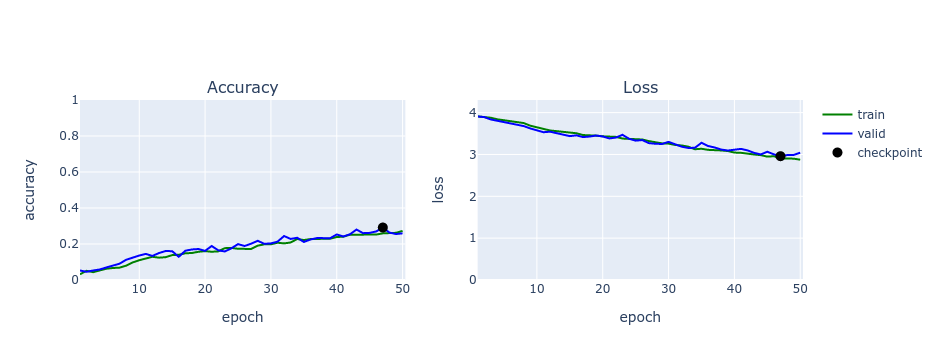

In [10]:
# Plot CNN 1 training metrics

plot_metrics_file(file_scratch_metrics)    


In [11]:
# Train CNN 2

n_epochs = 50
criterion_transfer = nn.NLLLoss()
optimizer_transfer = optim.SGD(model_transfer.classifier.parameters(), lr=0.01)

# Disable gradient calculations on features
for param in model_transfer.features.parameters():
    param.requires_grad = False

train(n_epochs, dls, model_transfer, optimizer_transfer, criterion_transfer, file_transfer_checkpoint, file_transfer_metrics, device)


Epoch: 1    Training acc: 0.176    Training loss: 3.600    Validation acc: 0.351    Validation loss: 3.046
Valid loss decreased - saving model to file.
Epoch: 2    Training acc: 0.383    Training loss: 2.893    Validation acc: 0.466    Validation loss: 2.461
Valid loss decreased - saving model to file.
Epoch: 3    Training acc: 0.471    Training loss: 2.460    Validation acc: 0.512    Validation loss: 2.153
Valid loss decreased - saving model to file.
Epoch: 4    Training acc: 0.513    Training loss: 2.202    Validation acc: 0.533    Validation loss: 2.022
Valid loss decreased - saving model to file.
Epoch: 5    Training acc: 0.555    Training loss: 2.011    Validation acc: 0.564    Validation loss: 1.874
Valid loss decreased - saving model to file.
Epoch: 6    Training acc: 0.588    Training loss: 1.881    Validation acc: 0.586    Validation loss: 1.792
Valid loss decreased - saving model to file.
Epoch: 7    Training acc: 0.605    Training loss: 1.775    Validation acc: 0.588    Vali

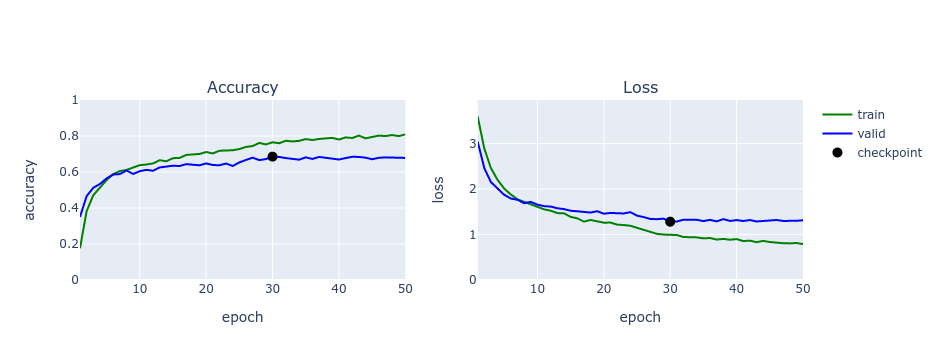

In [12]:
# Plot CNN 2 training metrics

plot_metrics_file(file_transfer_metrics)


### Testing

In [13]:
# Test CNN 1

model_scratch.load_state_dict(torch.load("model_scratch_checkpoint.pt"))
test(model_scratch, dls, criterion_scratch, device)

Test acc: 0.299    Test loss: 2.862


In [14]:
# Test CNN 2

model_transfer.load_state_dict(torch.load("model_transfer_checkpoint.pt"))
test(model_transfer, dls, criterion_transfer, device)

Test acc: 0.741    Test loss: 1.102


### Predict

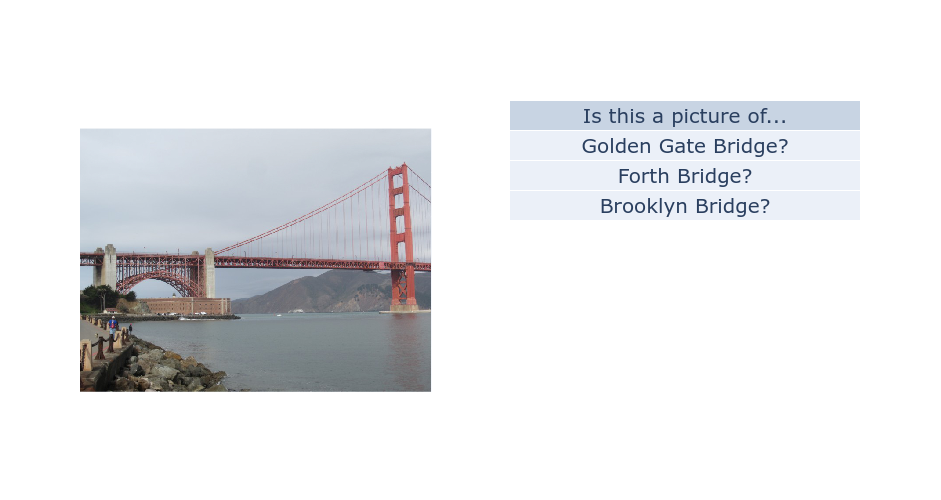

In [15]:
# Predict with best model

with open(file_categories, "r") as f:
    d_categories = json.load(f)

model_best = get_model_transfer()
model_best.load_state_dict(torch.load("model_transfer_checkpoint.pt"))
plot_top_k_categories(model_best, file_testme, d_categories, 3)
